**Detection and Visualization of Hatched Areas and Camera Coverage Using Image Processing Techniques.**


***Note:***
There are numerous deep learning approaches that can achieve more accurate results compared to the traditional image processing methods demonstrated in this report for both hatched area detection and camera coverage visualization. Notable models include YOLOv8, Mask R-CNN. There are also Models known as vision large language models such as Phi-3.5-Vision and MiniCPM-Llama3-V-2_5. These models can be fine-tuned using new techniques like Low Rank Adapter (LoRA) or more advanced methods like QLoRA to optimize their performance for these specific tasks.

In [17]:
import os
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

In [ ]:
# Load the image
image = cv2.imread('clinic.jpg')

# Plot the original image
cv2_imshow(image)

**PART 1**

**Hatched Area Calculation**

This part of the task involves detecting hatched regions in an image and calculating their total area.

**Image processing for Converting Hatched Areas to White Regions:**

The purpose of this image pre-processing pipeline is to detect and convert hatched regions into white areas for further analysis, specifically to calculate the area of these regions. The process involves multiple stages, including masking, color transformation, thresholding, edge detection, morphological operations, and filtering of noise. Below is a detailed description of each step performed in the code:



**Step 1: Creating Masks to Isolate Non-Black and Non-White Regions**

  *Objective*: To isolate and highlight the non-black and non-white regions in the image. This helps focus the processing on areas where hatched patterns are likely present.

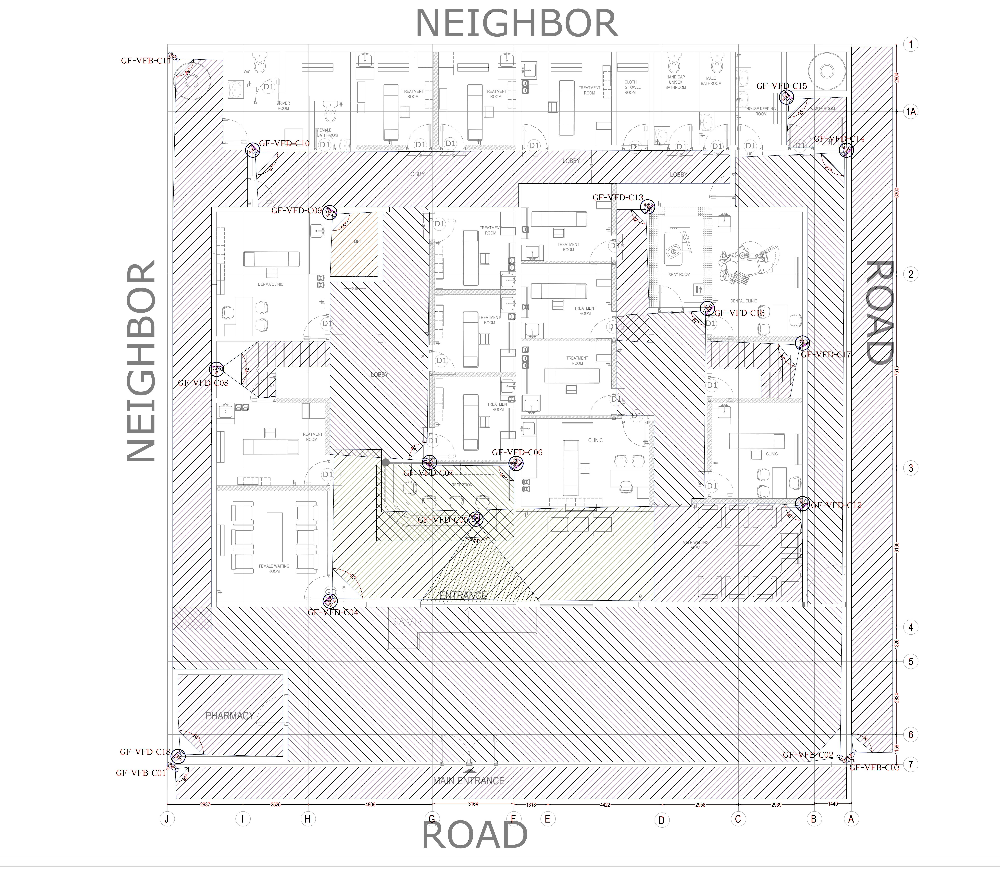

In [3]:
# Create a mask where pixels are not black or white
lower_black = np.array([0, 0, 0], dtype=np.uint8)
upper_black = np.array([30, 30, 30], dtype=np.uint8)  # Tolerance for black
lower_white = np.array([100, 100, 100], dtype=np.uint8)  # Tolerance for white
upper_white = np.array([255, 255, 255], dtype=np.uint8)

# Mask for black regions
mask_black = cv2.inRange(image, lower_black, upper_black)
# Mask for white regions
mask_white = cv2.inRange(image, lower_white, upper_white)

# Combine masks to identify non-black and non-white areas
mask = cv2.bitwise_not(cv2.bitwise_or(mask_black, mask_white))

# Create an output image where mostly non-black and non-white areas are turned to black
# The main idea here is to elemenate some colores at the first stage to achieve good results at the end.
output = image.copy()
output[mask == 255] = [0, 0, 0]

# Plot the processed image
cv2_imshow(output)


**Step 2: Converting the Image to Grayscale**

  *Objective*: To simplify the image by reducing it to a single channel. Grayscale images are easier to process and analyze for edge detection and thresholding. Thresholding used to segment the image into two regions: foreground (hatch areas) and background. This step aims to create a clear distinction between hatched and non-hatched areas.

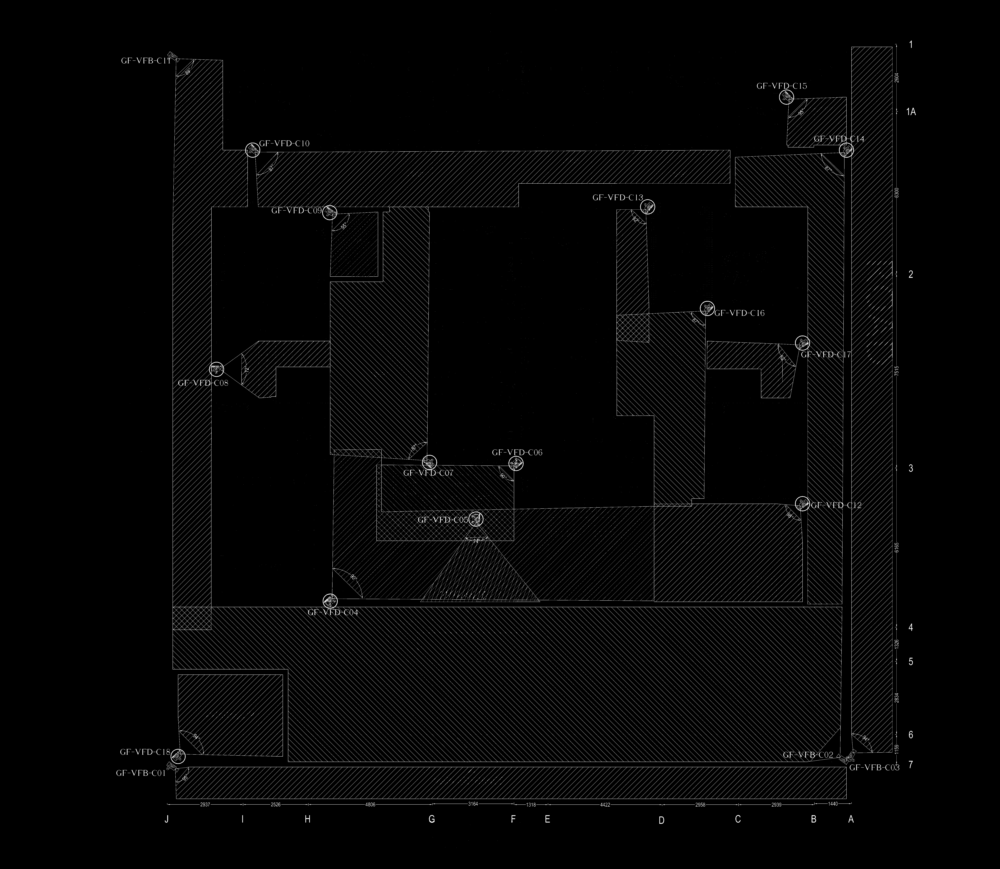

In [4]:
# Convert the image to grayscale
gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)

_, thresholded_image = cv2.threshold(gray, 90 , 255, cv2.THRESH_BINARY_INV)

# Plot the image (black/white)
cv2_imshow(thresholded_image)

**Step 3: Applying Gaussian Blur to Reduce Noise**

  *Objective*: To smooth the image and reduce noise, which can help improve the results of subsequent edge detection. Reducing noise prevents spurious edges from being detected.

  A canny edge detector are used also to detect the edges of the hatched regions. Edge detection highlights the boundaries of these regions, which are crucial for identifying and analyzing the shapes.

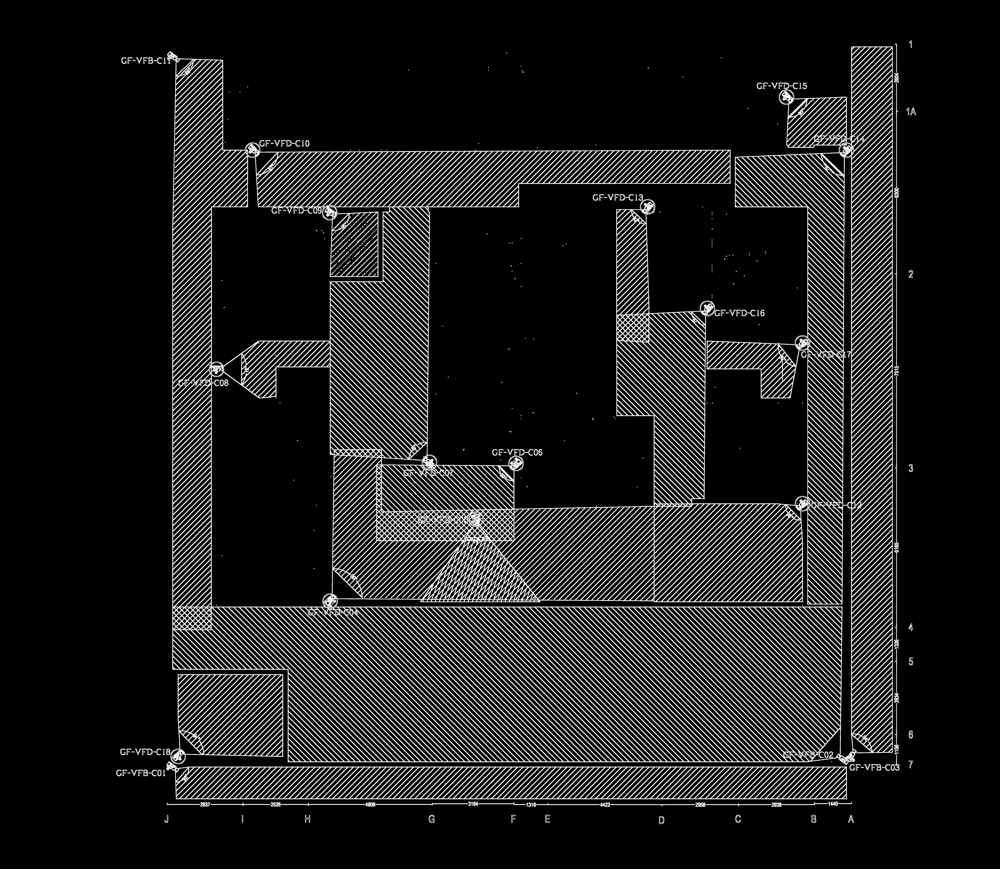

In [5]:
# Apply a Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(thresholded_image, (5, 5), 0)

# Apply Canny edge detection to detect edges
edges = cv2.Canny(blurred, 50, 150)

# Dilate the edges to enhance the lines
kernel = np.ones((3, 3), np.uint8)
dilated_edges = cv2.dilate(edges, kernel, iterations=1)

# Show the result
cv2_imshow(dilated_edges)
cv2.waitKey(0)
cv2.destroyAllWindows()

**Step 4: Filling Hatched Regions Using Morphological Closing + Identifying and Filtering Connected Components**

  *Objective*: To fill small holes and gaps within the detected edges.
  This step helps in creating solid shapes out of hatched areas,
  facilitating accurate area computation.

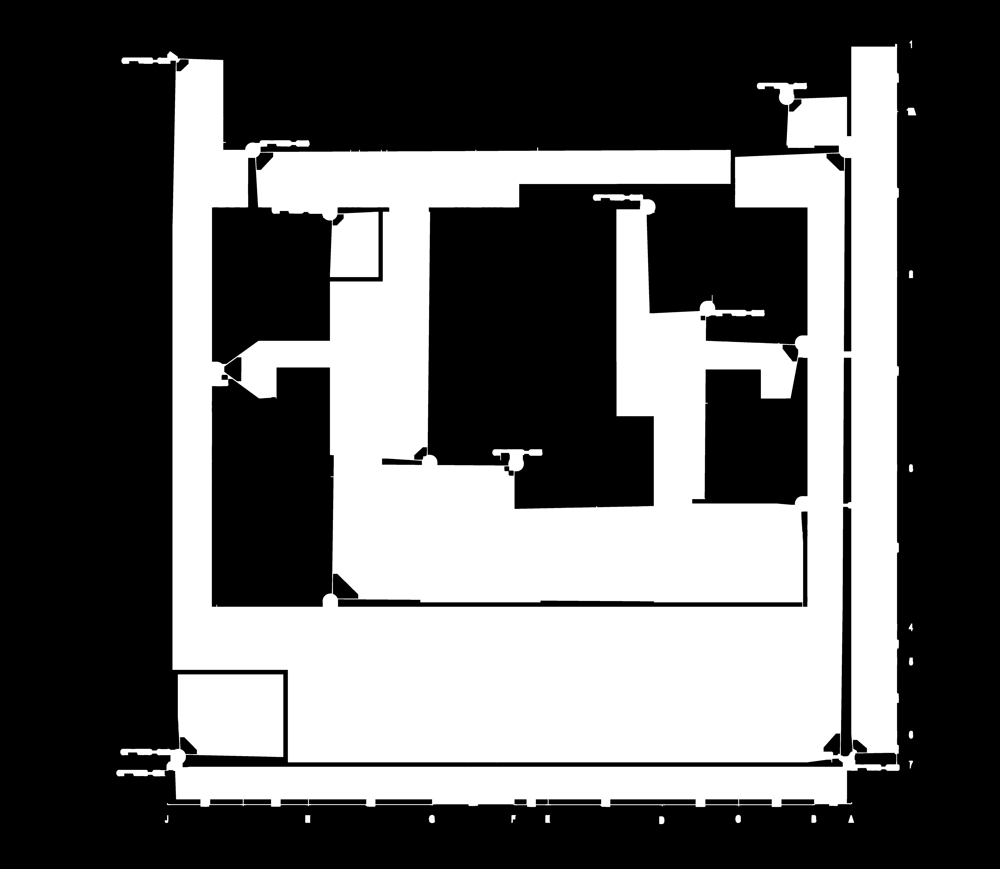

In [9]:
# Here we will fill the hatched Regions with white pixels using morphological operations & connected components algorithm.
# We will clean the image also

# Create a kernel for morphological operations
kernel = np.ones((30, 30), np.uint8)

# Perform morphological closing to fill small holes and gaps
closed = cv2.morphologyEx(dilated_edges, cv2.MORPH_CLOSE, kernel)

# Find all connected components (white regions)
num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(closed, connectivity=8)

# Filter out small components based on area
min_size = 500  # Minimum size of the components to keep
for i in range(1, num_labels):
    if stats[i, cv2.CC_STAT_AREA] < min_size:
        closed[labels == i] = 0  # Remove small white regions

cv2_imshow(closed)

**Step 5: Removing Small White Regions (Noise) Using Morphological Opening**

  *Objective*: To further clean the image by removing small white areas that might represent noise or irrelevant artifacts.

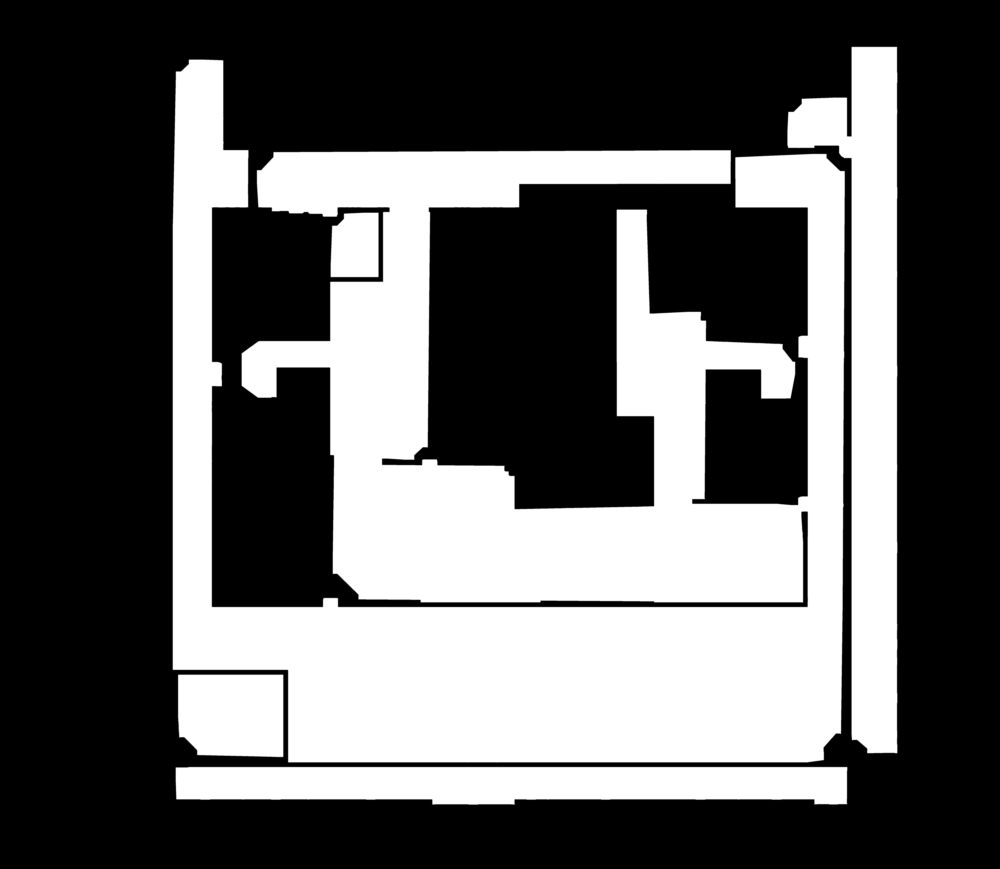

In [8]:
# Now we want to clean small white regions (noises)

# Create a kernel for morphological operations
kernel = np.ones((50, 50), np.uint8)

# Use morphological operations to remove small white pixel groups
# 'MorphologyEx' with 'OPEN' removes small white areas
opened = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel, iterations=2)

# Use connected components to filter out small white regions based on size
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(opened, connectivity=8)

# Create a mask to keep only the large components
min_size = 500  # Minimum size of connected components to keep
large_components_mask = np.zeros_like(opened)

for i in range(1, num_labels):  # Start from 1 to skip the background
    if stats[i, cv2.CC_STAT_AREA] >= min_size:
        large_components_mask[labels == i] = 255

# Use the mask to keep only the large regions
cleaned_image = cv2.bitwise_and(closed, large_components_mask)
cv2_imshow(cleaned_image)

**Final Step: Calculating the Area of Hatched Regions**

After processing the image to isolate and highlight hatched areas, the next step involves calculating the actual area covered by these hatched regions. The following code performs these calculations, converting the pixel count of the hatched areas into real-world measurements using the given scale and pixel-to-millimeter conversion factor. Below is a detailed explanation of each part of the code:

In [9]:
# now we can calculate the area of the hatched regions.
# from the original image we can measure how much mm represent each pixel.
# Each pixel represents 0.05446613312 mm.

# So we can calculate the area of each pixel as follow:
pixel_area_mm = 0.05446613312 ** 2  # Area of a single pixel in square millimeters

# From the original file we can determine the scale of the image which is given as 1:100
scale = 100

# Now we can calculate how many pixels our hatched regions represent. Just we need to calculate how many white pixels we have.

# Calculate the number of white pixels in the cleaned_image
hatched_pixels = cv2.countNonZero(cleaned_image)

# Total hatched area in square millimeters
total_hatched_area_mm2 = hatched_pixels * pixel_area_mm

print(f'Total hatched area on the image: {total_hatched_area_mm2} mm2')


# Total hatched area in square millimeters in real world
total_hatched_area_mm2_real_world = total_hatched_area_mm2 * (scale**2)

print(f'Total hatched area in real world (mm2): {total_hatched_area_mm2_real_world} mm2')

# Finaly convert the area in m2
total_hatched_area_real_world_m2 = total_hatched_area_mm2_real_world/(1000**2)

print(f'Total hatched area in real world (m2): {total_hatched_area_real_world_m2} m2')


Total hatched area on the image: 48142.015389816144 mm2
Total hatched area in real world (mm2): 481420153.8981615 mm2
Total hatched area in real world (m2): 481.42015389816146 m2


**PART 2**

**Camera Coverage Area Estimation**

The second part of the task involves estimating the coverage area of cameras based on their detected positions within an image. The approach described here uses image processing techniques to identify the locations of cameras by detecting blue circles that represent the cameras on a blueprint. Below is a detailed explanation of each step in the code for detecting the camera positions and visualizing them:

In [ ]:
import cv2
import numpy as np

# Load the image
image = cv2.imread('clinic.jpg')

# Convert the image to HSV color space
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Define the range of blue color in HSV
# These values may need adjustment depending on the specific shade of blue
lower_blue = np.array([100, 150, 50])
upper_blue = np.array([140, 255, 255])

# Create a mask to extract blue regions
mask = cv2.inRange(hsv, lower_blue, upper_blue)

# Optionally, you can apply a blur to reduce noise
blurred = cv2.GaussianBlur(mask, (9, 9), 2)

# Detect circles using HoughCircles
circles = cv2.HoughCircles(
    blurred,
    cv2.HOUGH_GRADIENT,
    dp=1.2,
    minDist=50,
    param1=50,
    param2=30,
    minRadius=20,
    maxRadius=50
)

# Ensure at least some circles were found
if circles is not None:
    # Convert the (x, y) coordinates and radius of the circles to integers
    circles = np.round(circles[0, :]).astype("int")

    for (x, y, r) in circles:
        # Draw the circle in the original image, then draw a rectangle
        # corresponding to the center of the circle
        cv2.circle(image, (x, y), r, (0, 255, 0), 4)
        cv2.rectangle(image, (x - 5, y - 5), (x + 5, y + 5), (0, 128, 255), -1)

        # Print the coordinates of each detected circle (camera position)
        print(f"Camera position: (x: {x}, y: {y})")

# Show the output image with detected circles
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


**Preparing a Copy of the Image for Processing**

  Objective: To work on a copy of the processed image (closed) rather than the original, ensuring that the original data remains unchanged followed by these steps:

  1 - Finding Contours.

  2 - Defining the Area Range for Contours to be Filled.

  3 - Looping Over Each Contour and Filling Eligible Ones.

Number of contours detected: 55


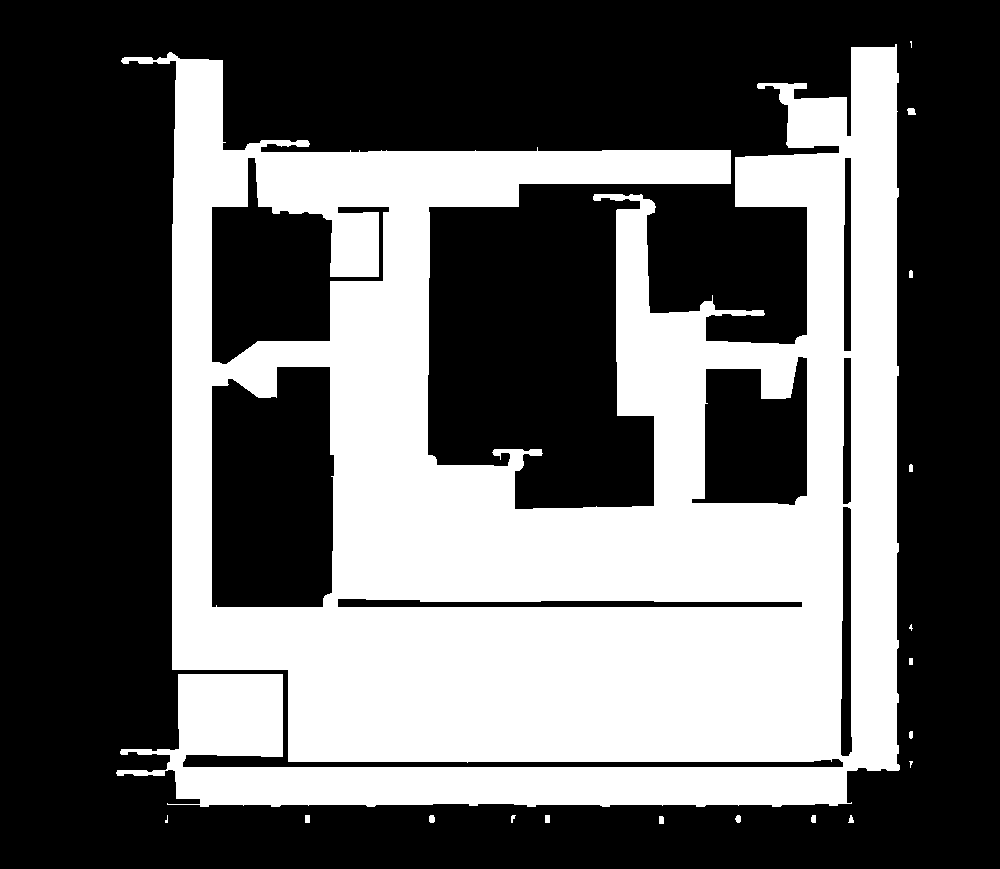

In [15]:
# We will need this Block of code for the task: computing camera coverage area

copy_image = closed.copy()

# Find the contours
contours, hierarchy = cv2.findContours(copy_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
print("Number of contours detected:", len(contours))

# Define the minimum and maximum area for the contours to be filled
min_area = 1000
max_area = 30000

# Loop over each contour
for cnt in contours:
    area = cv2.contourArea(cnt)

    # Check if the area is within the defined range
    if min_area < area < max_area:
        # Fill the contour with white color
        cv2.drawContours(copy_image, [cnt], -1, (255, 255, 255), thickness=cv2.FILLED)

# Display the result
cv2_imshow(copy_image)
cv2.waitKey(0)
cv2.destroyAllWindows()



**Camera Coverage Visualization**

The following steps outline the process of detecting camera coverage areas, ensuring accurate visualization of coverage on a floor plan. This involves using edge detection to create a wall mask, setting up camera specifications, validating camera positions, creating an overlay for visualization, and drawing the coverage areas for each camera. Each step is critical for accurate surveillance analysis and planning.

In [ ]:

# Apply edge detection to the above image
edges = cv2.Canny(copy_image, 50, 150, apertureSize=3)
cv2_imshow(edges)

# Create a refined wall mask based on filtered lines.
wall_mask = edges.copy()


# Define camera specifications: This Informations are found from Dahua Technology Website.
camera_range_in_meter = {
    "IPC-HDBW2101R-VFS": 30,
    "IPC-HDBW2231R-ZS-S2": 50,
    "IPC-HDBW5121E-Z": 30,
    "IPC-HFW2231T-ZS-S2": 50
}


# each pixel is around 0.00005446613312 meter (the dimention on provided file are used to compute this value).
meter_to_pixel_factor_real_scale = 18360   # (1 / 0.00005446613312)
meter_to_pixel_factor_image_scale = meter_to_pixel_factor_real_scale / 100. # (the scale is 1:100 as mentioned in the provided file)
camera_range_in_pixel = {key: int(value * meter_to_pixel_factor_image_scale) for key, value in camera_range_in_meter.items()}

cameras = [
    {"type": "IPC-HDBW2101R-VFS", "position": (5992, 1063), "fov": 87, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 135, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HDBW2101R-VFS", "position": (2333, 1505), "fov": 95, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 41, "y-shift":+20, "x-shift":+20},
    {"type": "IPC-HDBW2101R-VFS", "position": (5008, 2183), "fov": 87, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 133, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HDBW2101R-VFS", "position": (4585, 1463), "fov": 92, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 131, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HDBW2101R-VFS", "position": (1789, 1061), "fov": 87, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 45, "y-shift":+20, "x-shift":+20},
    {"type": "IPC-HDBW2101R-VFS", "position": (5681, 3566), "fov": 98, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 139, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HDBW2101R-VFS", "position": (5681, 2428), "fov": 82, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 139, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HDBW2101R-VFS", "position": (2337, 4256), "fov": 90, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": -45, "y-shift":-20, "x-shift":+20},
    {"type": "IPC-HDBW5121E-Z", "position": (3653, 3281), "fov": 90, "range": camera_range_in_pixel["IPC-HDBW5121E-Z"], "direction": 135, "y-shift":+20, "x-shift":-20},
    {"type": "IPC-HFW2231T-ZS-S2", "position": (1259, 5356), "fov": 94, "range": camera_range_in_pixel["IPC-HFW2231T-ZS-S2"], "direction": -45, "y-shift":-20, "x-shift":+20},
    {"type": "IPC-HDBW2101R-VFS", "position": (3041, 3273), "fov": 87, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": -135, "y-shift":-20, "x-shift":-20},
    {"type": "IPC-HDBW5121E-Z", "position": (3369, 3674), "fov": 74, "range": camera_range_in_pixel["IPC-HDBW5121E-Z"], "direction": 90, "y-shift":+20, "x-shift":0},
    {"type": "IPC-HDBW2101R-VFS", "position": (5570, 687), "fov": 95, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 45, "y-shift":+20, "x-shift":+20},
    {"type": "IPC-HDBW2101R-VFS", "position": (1533, 2617), "fov": 72, "range": camera_range_in_pixel["IPC-HDBW2101R-VFS"], "direction": 0, "y-shift":0, "x-shift":+20},
    {"type": "IPC-HDBW2231R-ZS-S2", "position": (1233, 5420), "fov": 95, "range": camera_range_in_pixel["IPC-HDBW2231R-ZS-S2"], "direction": 45, "y-shift":+20, "x-shift":+20},
    {"type": "IPC-HDBW2231R-ZS-S2", "position": (5887, 5293), "fov": 95, "range": camera_range_in_pixel["IPC-HDBW2231R-ZS-S2"], "direction": -135, "y-shift":-20, "x-shift":-20},
    {"type": "IPC-HDBW2231R-ZS-S2", "position": (6014, 5260), "fov": 94, "range": camera_range_in_pixel["IPC-HDBW2231R-ZS-S2"], "direction": -45, "y-shift":-20, "x-shift":+20},
    {"type": "IPC-HFW2231T-ZS-S2", "position": (1230, 408), "fov": 89, "range": camera_range_in_pixel["IPC-HFW2231T-ZS-S2"], "direction": 45, "y-shift":+20, "x-shift":+20},

]

# Check if camera positions are within image dimensions
image_height, image_width = image.shape[:2]
for camera in cameras:
    cam_x, cam_y = camera["position"]
    if not (0 <= cam_x < image_width and 0 <= cam_y < image_height):
        print(f"Warning: Camera {camera['type']} at position {camera['position']} is out of image bounds.")
        continue

# Create an overlay for coverage visualization
overlay = np.zeros_like(image, dtype=np.uint8)

# Function to check if a point is blocked by a wall
def is_blocked(x, y):
    if y < 0 or y >= wall_mask.shape[0] or x < 0 or x >= wall_mask.shape[1]:
        return True
    return wall_mask[y, x] == 255  # Check for wall presence

# Function to draw the coverage area on the overlay
def draw_coverage(overlay, position, fov, coverage_range, direction=0, y_shift=0, x_shift=0):
    (x, y) = position
    y+=y_shift
    x+=x_shift
    start_angle = direction - (fov / 2)  # Starting angle of the sector
    end_angle = direction + (fov / 2)    # Ending angle of the sector
    drawn = False
    for angle in np.linspace(start_angle, end_angle, 100):
        radian = np.deg2rad(angle)
        for r in range(0, coverage_range):

            new_x = int(x + r * np.cos(radian))
            new_y = int(y + r * np.sin(radian))
            if 0 <= new_x < overlay.shape[1] and 0 <= new_y < overlay.shape[0]:
                if is_blocked(new_x, new_y):
                   break
                overlay[new_y, new_x] = (255, 0, 0)  # Blue color for coverage
                drawn = True
            else:
                break


    if drawn:
        print(f"Coverage drawn for camera at position {position}.")
    else:
        print(f"No coverage drawn for camera at position {position} due to walls.")

    # Draw the camera position
    cv2.circle(overlay, (x, y), 20, (0, 255, 0), -1)  # Camera marker (green circle)

# Draw the coverage area for each camera on the overlay
for camera in cameras:
    draw_coverage(
        overlay,
        camera["position"],
        camera["fov"],
        camera["range"],
        direction=camera["direction"],  # Camera orientation (0 = east, 180 = west, etc.)
        y_shift=camera["y-shift"],
        x_shift=camera["x-shift"]
    )

# Visualize the overlay before blending
cv2_imshow(overlay)
cv2.waitKey(0)

# Now, blend the overlay with the original image using transparency
alpha = 0.8  # Transparency factor
blue_mask = overlay[:, :, 0] > 0  # Find all areas where blue (coverage) is drawn

for c in range(0, 3):
    image[:, :, c] = np.where(blue_mask, cv2.addWeighted(overlay[:, :, c], alpha, image[:, :, c], 1 - alpha, 0), image[:, :, c])

# Show the result
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

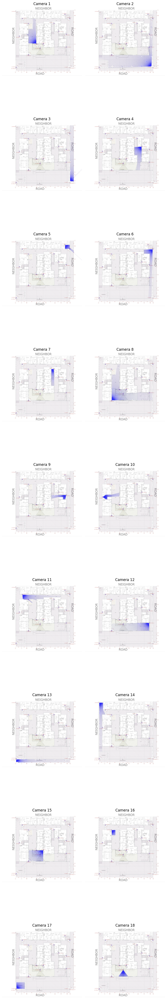

In [41]:

# Plot each camera coverage area seperatly
image_folder = 'images'

# List all files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Number of images to display
num_images = len(image_files)

# Define number of rows and columns for the grid based on the number of images
rows = 9
cols = 2

# Create a figure with the specified size
fig, axes = plt.subplots(rows, cols, figsize=(8, 50))

# Iterate over the images and axes to display each image
for i, ax in enumerate(axes.flat):
    if i < num_images:
        img_path = os.path.join(image_folder, image_files[i])
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for displaying
        ax.imshow(img)
        ax.set_title(f'Camera {i + 1}')
        ax.axis('off')  # Hide the axis for a cleaner look
    else:
        ax.axis('off')  # Hide empty subplots

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

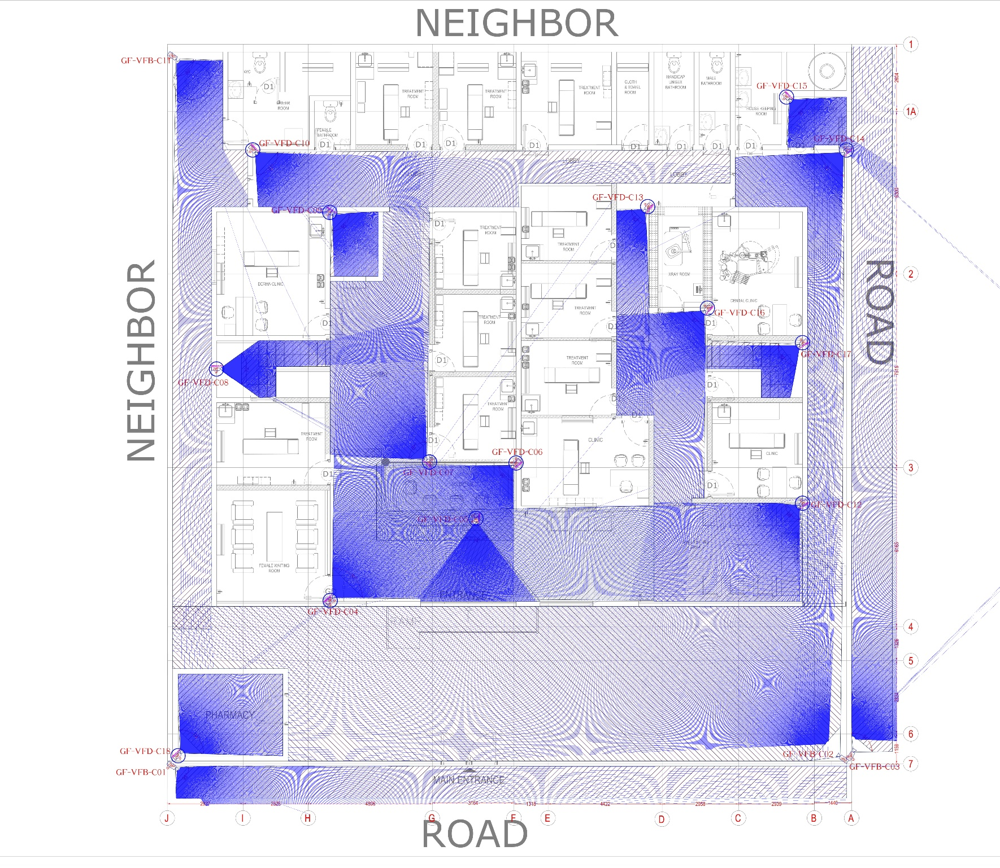

In [42]:
# Load the full image with all cameras (more accurate than above)

# Load the image
image = cv2.imread('all-cameras.jpg')

# Plot the original image
cv2_imshow(image)

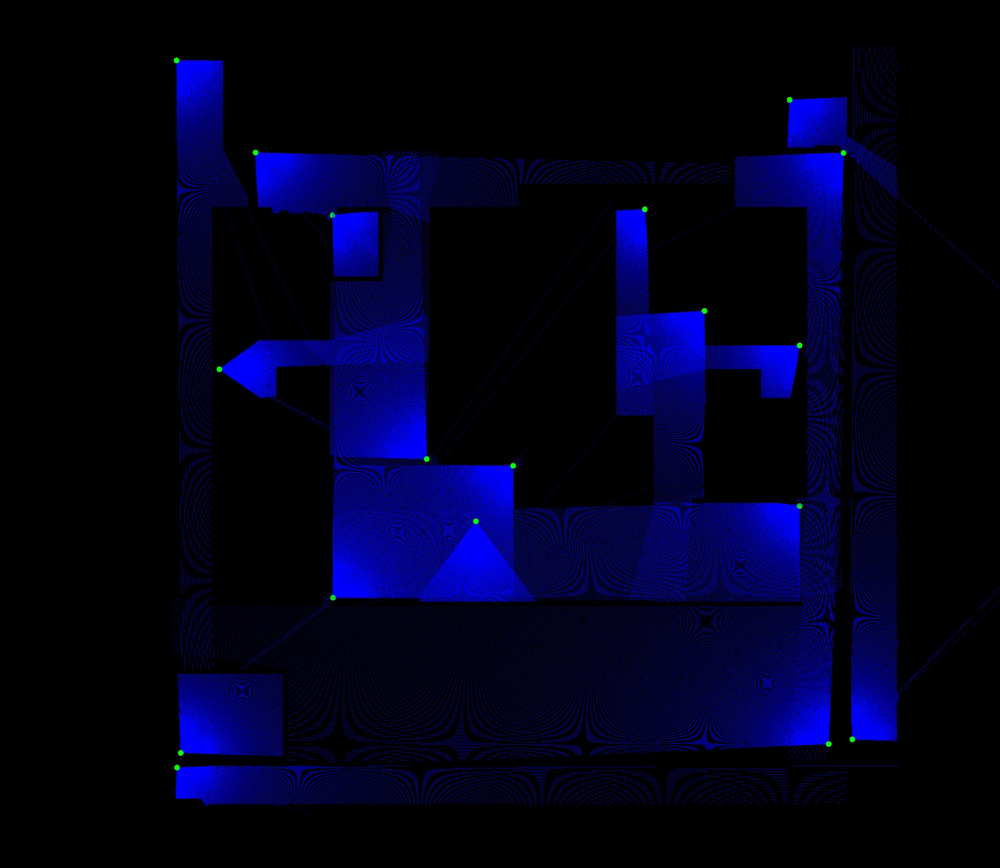

In [43]:
# Accurate Overlay

# Load the image
overlay = cv2.imread('overlay.jpg')

# Plot the original image
cv2_imshow(overlay)

**Conclusion**

This task successfully demonstrates a comprehensive approach to analyzing and visualizing hatched areas and camera coverage in a given floor plan. In the first part, hatched regions are accurately detected and measured by leveraging image pre-processing techniques, such as color masking, thresholding, edge detection, and morphological operations. These methods ensure precise isolation of hatched areas, allowing for accurate area calculations in both pixel-based and real-world dimensions.

In the second part, the process of visualizing camera coverage is achieved by setting up camera specifications, validating their positions, and using edge detection to identify walls and obstacles. By creating a wall mask and defining coverage overlays, The code simulates real-world conditions, taking into account obstructions that may affect the camera's field of view. The visualization of camera coverage areas provides clear insights into surveillance effectiveness, highlighting covered and uncovered zones, and enabling informed decisions on camera placement and optimization.

However, it is important to note that these **traditional techniques** are not the only solution to the problem. **Deep learning approaches, such as object detection and segmentation using models like YOLOv8 and Mask R-CNN, can achieve more accurate results for both hatched area detection and camera coverage visualization.** These advanced methods require adapting and fine-tuning the models to the specific use case using high-quality labeled datasets.

For the first part (hatched area calculation), a high quality dataset is required that accurately reflects the format needed for fine-tuning YOLOv8 or Mask R-CNN. This dataset would include annotated images where hatched regions are clearly labeled, providing the necessary training data to enhance model accuracy.

For the second part (camera coverage visualization), it is essential to provide detailed annotations that include the exact position of each camera and the specific regions each camera can cover. This labeled data will enable the models to learn and predict camera coverage areas more effectively.

By preparing such datasets and fine-tuning the deep learning models on them, we can automate the process of calculating hatched areas and visualizing camera coverage with greater accuracy and efficiency. This approach will not only streamline the workflow but also ensure higher precision in real-world applications, such as security planning, architectural design, and facility management.